# Segmentación del conjunto de Imágenes del Cultivo de Naranjas en Linares con el modelo propuesto de Red Neuronal Convolucional con Arquitectura Dyanmic U-Net con fastai.

In [1]:
from google.colab import files

In [2]:
## Mount notebook to Google Drive
from google.colab import drive
import os
drive.mount("/content/drive", force_remount=True)
os.chdir('/content/drive/My Drive/Colab Notebooks/Linares')

Mounted at /content/drive


### Librerias necesarias:

In [3]:
%matplotlib inline
%reload_ext autoreload
%autoreload 2

In [4]:
from fastai.vision.all import *

import matplotlib as mpl
import numpy as np
import pandas as pd
import torch
from torchvision.transforms import ToPILImage

from PIL import Image
from IPython.display import display
from pathlib import Path
import gc

np.random.seed(42)
torch.manual_seed(42)

El siguiente comando nos permite saber si contamos con una GPU compatible con CUDA (NVIDIA):

In [7]:
torch.cuda.is_available()

True

In [8]:
torch.cuda.empty_cache()

## 1. Definición de ruta para el ambiente de trabajo

Definimos nuestra ruta dentro del directorio actual:

In [9]:
path = './'

In [10]:
!cat {path}

cat: ./: Is a directory


Definimos rutas para nuestros directorios donde se encuntran nuestros conjuntos de images y mascaras de segmentación 'labels':

In [11]:
path_lbl = path+'labels'
path_img = path+'images'

## 2. Visualizacion de los datos

Extraemos los nombres de las imágenes por medio de la función "get_image_files":

Imagen original:

In [12]:
fnames = get_image_files(path_img)

In [13]:
fnames[0]

Path('images/DJI_0758.JPG')

Imagen de mascara de segmentación:

In [14]:
lbl_names = get_image_files(path_lbl)
lbl_names[0]

Path('labels/Mask_0759.tif')

Con la libreria PIL podemos cargar y mostrar las imágenes:

In [15]:
img_f = fnames[0]
img = PILImage.create(img_f)

Hacemos un resize a la mitad de la resulución para poder mostrar la imagen dentro de la notebook:

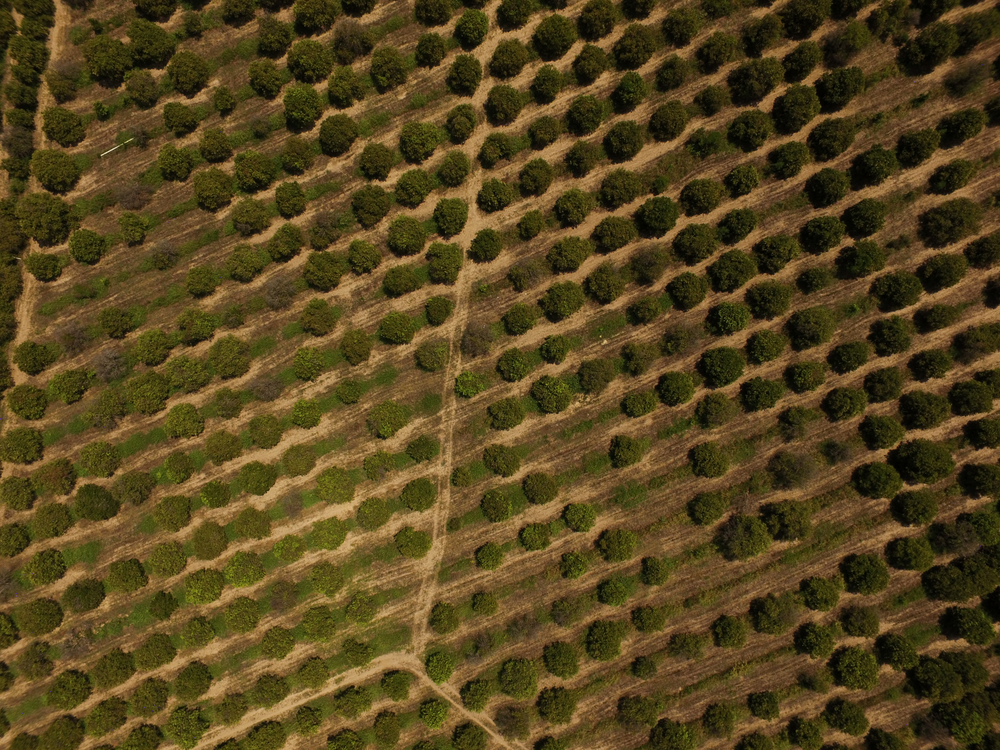

In [16]:
img_resized = img.resize((2000, 1500))
img_resized

### 2.1 Definición de Funciones para etiquetar las imagenes

Función para mapear imágenes originales con su correspondiente mascara de segmentación en 'path_lbl':

In [17]:
def label_func(x): return path_lbl+"/"+'Mask_'+x.stem.split('_')[1]+'.tif'

Función para convertir de clases a códigos:

In [18]:
def n_codes(fnames, is_partial=True):
  vals = set()
  if is_partial:
    random.shuffle(fnames)
    fnames = fnames[:10]
  for fname in fnames:
    msk = np.array(PILMask.create(fname))
    for val in np.unique(msk):
      if val not in vals:
        vals.add(val)
  vals = list(vals)
  p2c = dict()
  for i,val in enumerate(vals):
    p2c[i] = vals[i]
  return p2c

In [19]:
def get_msk(fn, pix2class):
  fn = label_func(fn)
  msk = np.array(PILMask.create(fn))
  mx = np.max(msk)
  for i, val in enumerate(pix2class):
    msk[msk==pix2class[i]] = val
  return PILMask.create(msk)

In [20]:
vals = n_codes(lbl_names)
vals

{0: np.uint8(0),
 1: np.uint8(196),
 2: np.uint8(132),
 3: np.uint8(209),
 4: np.uint8(114),
 5: np.uint8(182),
 6: np.uint8(255)}

In [21]:
codes = np.loadtxt(path+'/codes.txt', dtype=str)
codes

array(['Void', 'Arbol', 'Plaga', 'Suelo_Claro', 'Suelo_Oscuro',
       'Vegetacion', 'White'], dtype='<U12')

In [22]:
get_y = lambda o: get_msk(o, vals)

Visualizar ejemplo de mascara de segmentación:

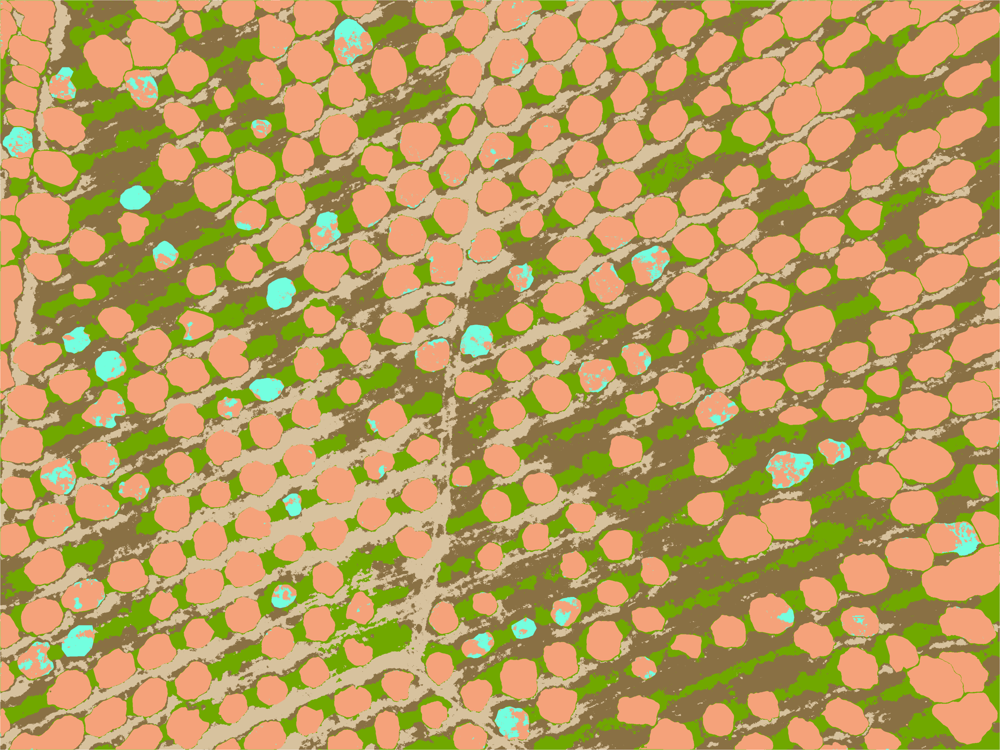

In [23]:
org_to_mask = PILImage.create(label_func(img_f))
org_to_resized = org_to_mask.resize((2000, 1500))
org_to_resized

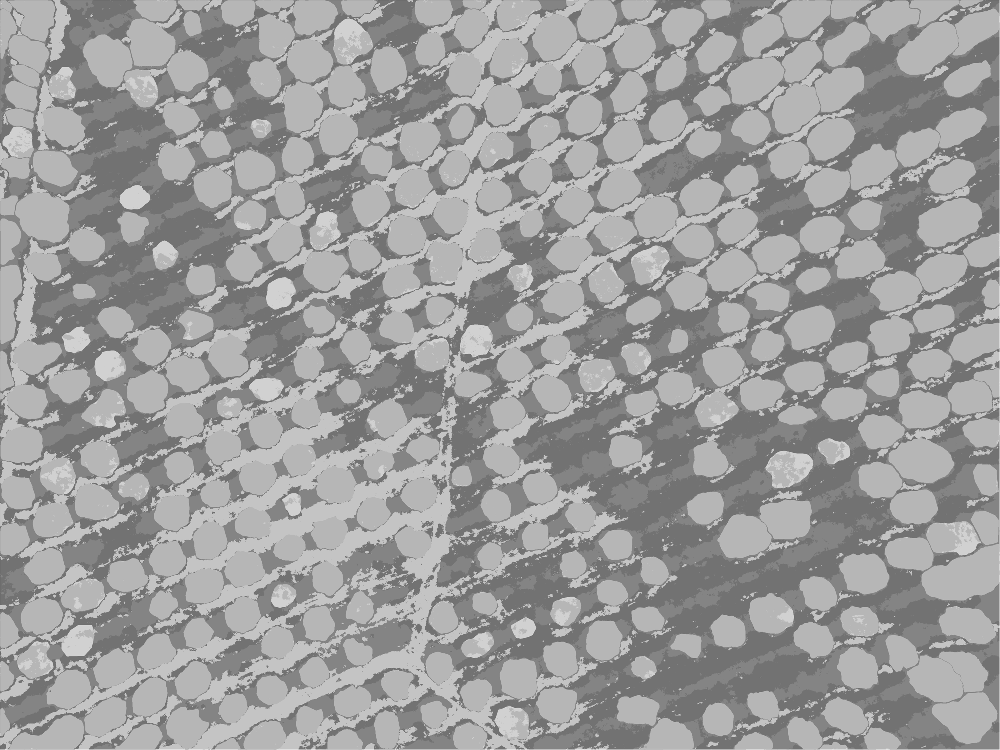

In [24]:
mask = PILMask.create(label_func(img_f))
mask_resized = mask.resize((2000, 1500))
mask_resized

In [25]:
src_size = mask.shape
src_size,tensor(mask)

((3000, 4000),
 tensor([[255, 255, 255,  ..., 255, 255, 255],
         [255, 132, 132,  ..., 114, 114, 255],
         [255, 132, 132,  ..., 114, 114, 255],
         ...,
         [255, 114, 114,  ..., 132, 132, 255],
         [255, 114, 114,  ..., 132, 132, 255],
         [255, 255, 255,  ..., 255, 255, 255]], dtype=torch.uint8))

## 3. Cargar los datos con Data Block

Un "Data block" es un concepto de fastai, que ofrece una manera flexible y poderosa de transformar datos brutos en un formato adecuado para el entrenamiento de modelos de aprendizaje automático. Esencialmente, es un sistema para construir bloques de datos, donde cada bloque es un componente que puede personalizarse para manejar diferentes tipos de entradas de datos, como imágenes, textos o datos tabulares. La API de Data block ayuda a aplicar secuencialmente diversas transformaciones y a dividir los datos en conjuntos de entrenamiento y validación, asegurando que los datos estén listos para el entrenamiento del modelo.

In [26]:
half = tuple(int((x/2)) for x in src_size); half

(1500, 2000)

In [28]:
linares= DataBlock(blocks=(ImageBlock, MaskBlock(codes)),
                   get_items=get_image_files,
                   splitter=RandomSplitter(),
                   get_y=get_y,
                   item_tfms=Resize(half),
                   batch_tfms=[
                       #*aug_transforms(),
                       #size = (750,1000),
                       #min_scale = 0.8,
                       #max_lighting=0.8),
                       Normalize.from_stats(*imagenet_stats)])

In [29]:
dls = linares.dataloaders("./images", bs=1, path=path)

### Ahora mostraremos un batch de imágenes:

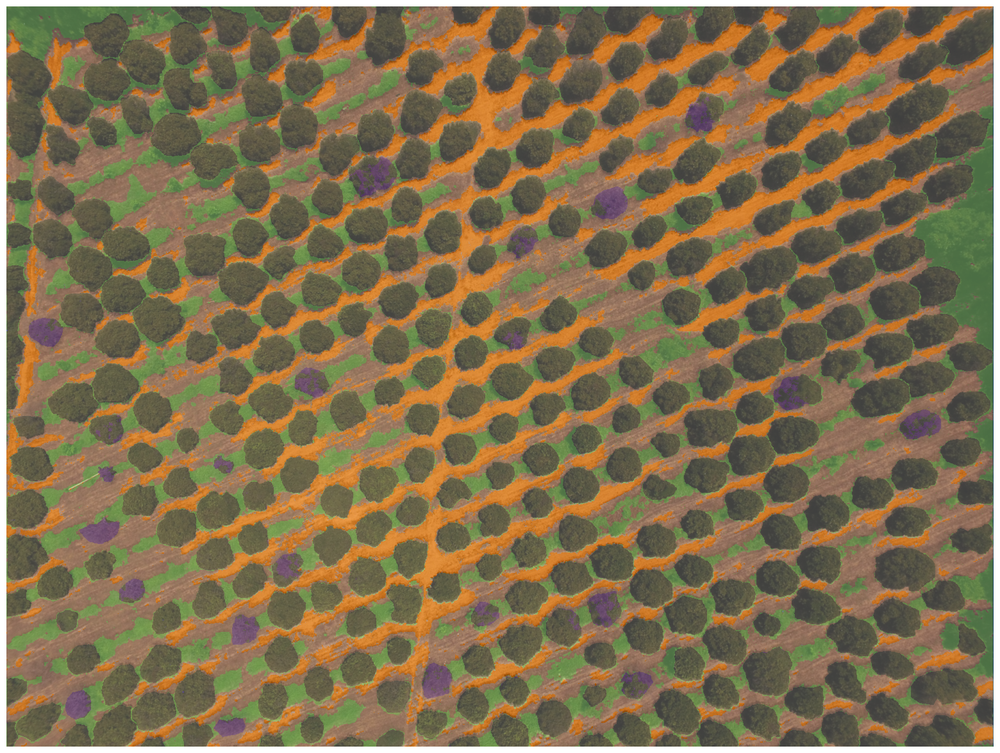

In [30]:
dls.show_batch(max_n=3, figsize=(20,15))

## 4. Metricas del modelo

In [31]:
def acc_segmentation(input, target):
    target = target.squeeze(1)
    mask = torch.logical_or(target != void_code, target != white_code)
    return (input.argmax(dim=1)[mask]==target[mask]).float().mean()

In [32]:
name2id = {v:k for k,v in enumerate(codes)}
void_code = name2id['Void']
white_code = name2id['White']

In [33]:
void_code

0

In [34]:
white_code

6

In [35]:
name2id

{np.str_('Void'): 0,
 np.str_('Arbol'): 1,
 np.str_('Plaga'): 2,
 np.str_('Suelo_Claro'): 3,
 np.str_('Suelo_Oscuro'): 4,
 np.str_('Vegetacion'): 5,
 np.str_('White'): 6}

In [36]:
metrics=acc_segmentation
wd=1e-2
dls.vocab = codes

In [37]:
codes

array(['Void', 'Arbol', 'Plaga', 'Suelo_Claro', 'Suelo_Oscuro',
       'Vegetacion', 'White'], dtype='<U12')

## 5. Modelo: Dynamic Unet + ResNet34

ResNet34 es una variante de la arquitectura de Redes Residuales que incluye 34 capas. Es ampliamente utilizada en tareas de clasificación de imágenes debido a su capacidad para permitir el entrenamiento de redes profundas mediante el uso de atajos o conexiones entre capas para pasar la entrada de una capa a la siguiente, aliviando así el problema del desvanecimiento del gradiente. Esta estructura ayuda a la red a aprender una función de identidad que asegura que las capas superiores al menos funcionarán tan bien como las inferiores, y no peor. ResNet34, como se implementa en la biblioteca fastai, está optimizada para facilidad de uso y rendimiento, específicamente diseñada para prototipado rápido y experimentación en aplicaciones educativas y prácticas.

DynamicUnet es una arquitectura flexible adaptada del modelo U-Net, que se utiliza principalmente para tareas de segmentación semántica, donde el objetivo es clasificar cada píxel de una imagen en una categoría. El aspecto "dinámico" de DynamicUnet en fastai proviene de su capacidad para ajustarse a las especificidades de los datos de entrada. Puede adaptarse automáticamente a diferentes tamaños de entrada y diferentes números de clases de salida sin necesidad de rediseñar manualmente el modelo. Esta adaptabilidad lo hace particularmente útil para tareas que requieren localización detallada y contexto, como la segmentación de imágenes médicas.

In [38]:
learn = unet_learner(dls, arch=resnet34, metrics=metrics)

Downloading: "https://download.pytorch.org/models/resnet34-b627a593.pth" to /root/.cache/torch/hub/checkpoints/resnet34-b627a593.pth
100%|██████████| 83.3M/83.3M [00:00<00:00, 231MB/s]


In [39]:
learn.summary()

DynamicUnet (Input shape: 1 x 3 x 1500 x 2000)
Layer (type)         Output Shape         Param #    Trainable 
                     1 x 64 x 750 x 1000 
Conv2d                                    9408       False     
BatchNorm2d                               128        True      
ReLU                                                           
____________________________________________________________________________
                     1 x 64 x 375 x 500  
MaxPool2d                                                      
Conv2d                                    36864      False     
BatchNorm2d                               128        True      
ReLU                                                           
Conv2d                                    36864      False     
BatchNorm2d                               128        True      
Conv2d                                    36864      False     
BatchNorm2d                               128        True      
ReLU                    

## 6. Entrenamiento

/usr/local/lib/python3.11/dist-packages/fastai/learner.py:53: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state = torch.load(file, map_location=device, **torch_load_kwargs

SuggestedLRs(valley=0.00019054606673307717)

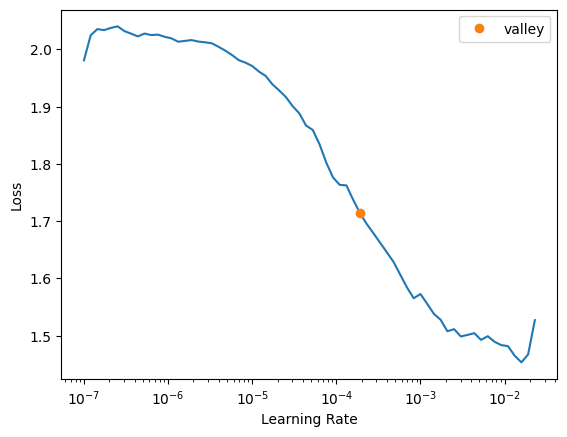

In [ ]:
learn.lr_find()

In [ ]:
lr = 1e-04

In [ ]:
learn.fit_one_cycle(10, slice(lr), pct_start=0.9, wd=wd)

epoch,train_loss,valid_loss,acc_segmentation,time
0,1.906824,1.803858,0.308074,00:20
1,1.746494,1.485887,0.329398,00:19
2,1.551705,1.208052,0.379998,00:19
3,1.399337,1.039650,0.594289,00:19
4,1.264935,0.831187,0.643071,00:19
5,1.145519,0.774626,0.679874,00:19
6,1.044437,0.637409,0.761756,00:19
7,0.944212,0.724024,0.723118,00:19
8,0.857773,0.512043,0.807887,00:19
9,0.775732,0.494761,0.811199,00:19


SuggestedLRs(valley=0.0002754228771664202)

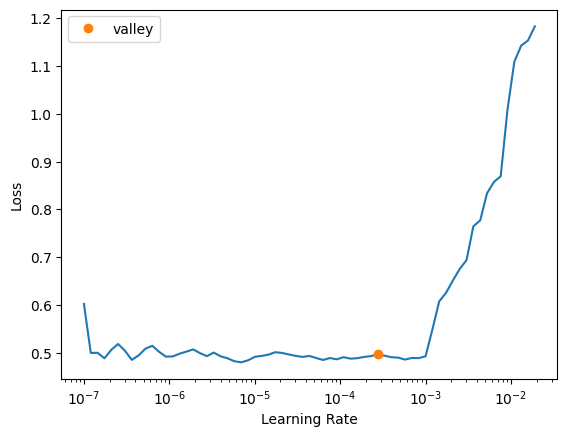

In [ ]:
learn.lr_find()

In [ ]:
lr= 3e-04

In [ ]:
learn.fit_one_cycle(10, slice(lr), pct_start=0.9, wd=wd)

epoch,train_loss,valid_loss,acc_segmentation,time
0,0.491927,0.476825,0.819479,00:19
1,0.486872,0.477725,0.819473,00:19
2,0.475185,0.490921,0.809413,00:19
3,0.473207,0.502244,0.805962,00:19
4,0.492001,0.566192,0.777813,00:19
5,0.528167,0.695763,0.684053,00:19
6,0.571374,0.647563,0.748034,00:19
7,0.582567,0.462663,0.825423,00:19
8,0.555102,0.493506,0.814192,00:19
9,0.525344,0.420021,0.842381,00:19


In [ ]:
learn.save('model-stage-1')

In [ ]:
gc.collect()

25847

In [ ]:
learn.load('model-stage-1', weights_only=False);

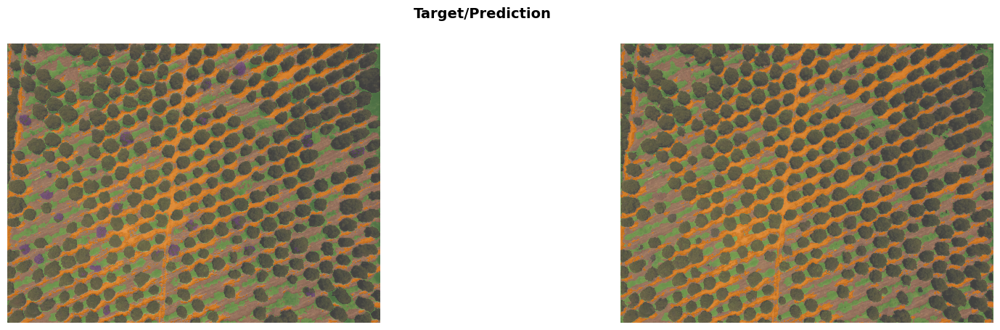

In [ ]:
learn.show_results(max_n=3, figsize=(20, 5))

In [ ]:
learn.unfreeze()

SuggestedLRs(valley=5.248074739938602e-05)

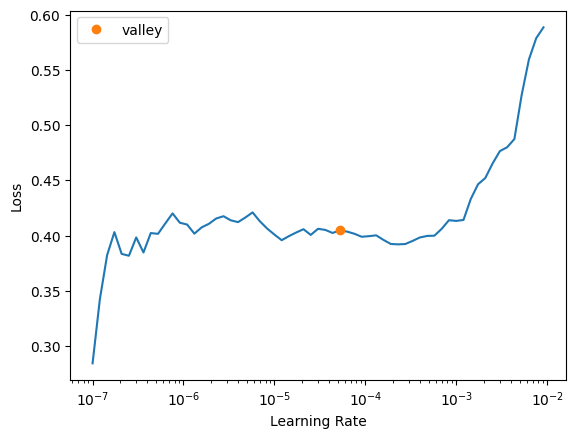

In [ ]:
learn.lr_find()

In [ ]:
lr = 5e-05

In [ ]:
learn.fit_one_cycle(15, lr, pct_start=0.8, wd=wd)

epoch,train_loss,valid_loss,acc_segmentation,time
0,0.399067,0.408023,0.846112,00:20
1,0.390939,0.407611,0.844950,00:20
2,0.383853,0.400172,0.847199,00:20
3,0.377843,0.400471,0.846498,00:20
4,0.370322,0.401314,0.846537,00:20
5,0.362800,0.402081,0.845201,00:20
6,0.356067,0.391392,0.850709,00:20
7,0.348958,0.403324,0.844252,00:20
8,0.340211,0.392530,0.850856,00:20
9,0.335404,0.392827,0.849907,00:20


In [ ]:
learn.save('model-stage-2');

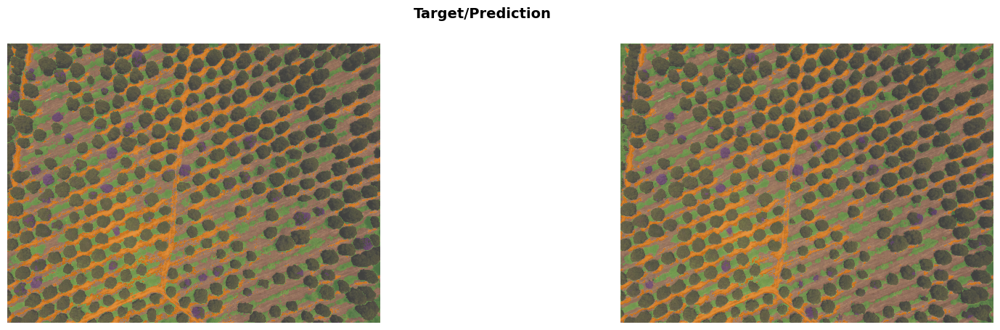

In [ ]:
learn.show_results(max_n=3, figsize=(20, 5))

## 6.1 Más entrenamiento
Estábamos entrenando con la mitad de tamaño. Ahora entrenaremos con tamaño completo

In [ ]:
del learn
gc.collect()

19164

In [ ]:
dls_full = linares.dataloaders("./images", size=src_size, bs=1, path=path)

In [ ]:
learn = unet_learner(dls_full, resnet34, metrics=metrics)

In [ ]:
learn.load('model-stage-2', weights_only=False);

In [ ]:
learn.freeze()

SuggestedLRs(valley=1.2022644114040304e-05)

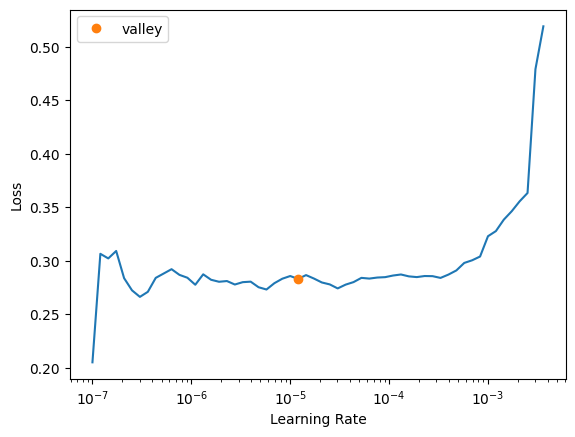

In [ ]:
learn.lr_find()

In [ ]:
learn.fit_one_cycle(10, slice(1e-6, 1e-5), pct_start=0.8)

epoch,train_loss,valid_loss,acc_segmentation,time
0,0.286585,0.259253,0.896946,00:19
1,0.283903,0.260754,0.896480,00:19
2,0.283450,0.261248,0.896353,00:19
3,0.282798,0.261959,0.896126,00:19
4,0.282255,0.262720,0.895607,00:19
5,0.281140,0.262957,0.895595,00:19
6,0.280857,0.263803,0.895015,00:19
7,0.279724,0.260682,0.896558,00:19
8,0.278427,0.262614,0.895895,00:19
9,0.277126,0.258525,0.897306,00:19


In [ ]:
learn.save('model-stage-1-full')

In [ ]:
learn.validate()

(#2) [0.25852468609809875,0.8973061442375183]

In [ ]:
learn.unfreeze()

/usr/local/lib/python3.11/dist-packages/fastai/learner.py:53: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state = torch.load(file, map_location=device, **torch_load_kwargs

SuggestedLRs(valley=9.120108734350652e-05)

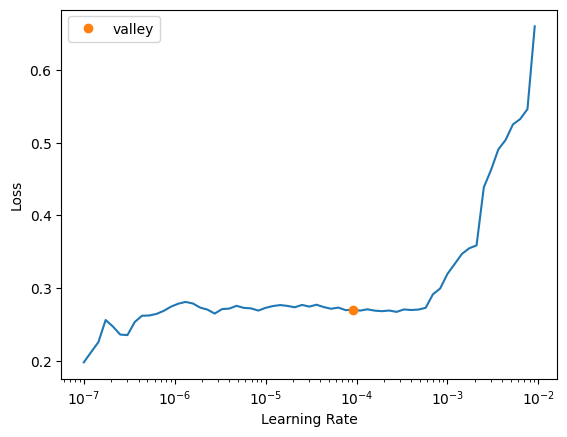

In [ ]:
learn.lr_find()

In [ ]:
learn.fit_one_cycle(10, slice(1e-05, 1e-04), pct_start=0.8)

epoch,train_loss,valid_loss,acc_segmentation,time
0,0.273378,0.259357,0.897060,00:20
1,0.271181,0.262071,0.895816,00:20
2,0.273383,0.265852,0.894336,00:20
3,0.270275,0.262180,0.895670,00:20
4,0.267855,0.268765,0.893397,00:20
5,0.267074,0.279757,0.890218,00:20
6,0.270402,0.272619,0.892064,00:20
7,0.269522,0.282710,0.885872,00:20
8,0.268255,0.275396,0.891544,00:20
9,0.262151,0.255638,0.898495,00:20


SuggestedLRs(valley=2.0892961401841603e-05)

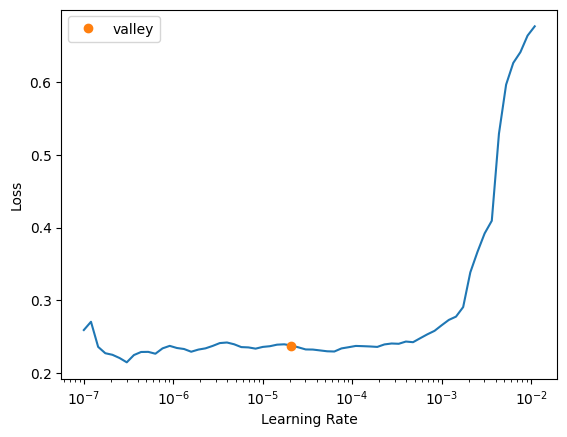

In [ ]:
learn.lr_find()

In [ ]:
learn.fit_one_cycle(15, slice(8e-06, 2e-05), pct_start=0.8)

epoch,train_loss,valid_loss,acc_segmentation,time
0,0.234922,0.257114,0.897855,00:20
1,0.234922,0.253825,0.899217,00:20
2,0.233609,0.251592,0.900148,00:20
3,0.231920,0.250635,0.900625,00:20
4,0.230549,0.249291,0.901289,00:20
5,0.229531,0.248771,0.901878,00:20
6,0.228734,0.246956,0.901966,00:20
7,0.227970,0.255710,0.899334,00:20
8,0.227004,0.243798,0.903476,00:20
9,0.224927,0.253271,0.901223,00:20


In [ ]:
learn.save('model-stage-2-full')

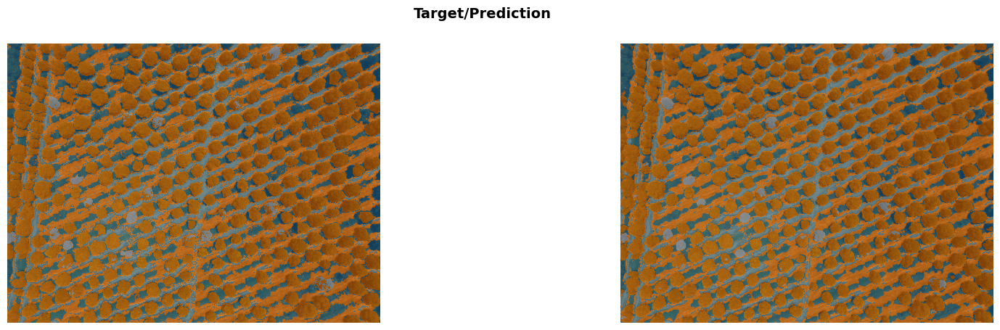

In [ ]:
learn.show_results(max_n=3, figsize=(20, 5), vmin=1, vmax=30)

## 7. Interpretación

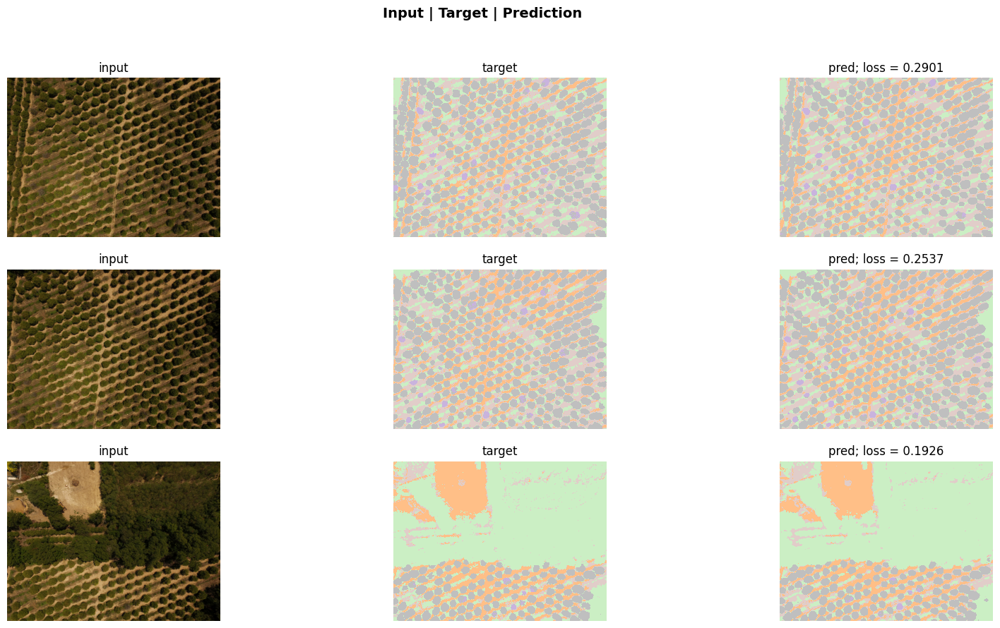

In [ ]:
interp = SegmentationInterpretation.from_learner(learn)
interp.plot_top_losses(k=3, figsize=(20,10))

In [ ]:
interp.top_losses(k=3)

(TensorBase([0.2901, 0.2537, 0.1926]), TensorBase([0, 1, 2]))

In [ ]:
losses,idxs = interp.top_losses(k=3)
file_names = [dls_full.valid_ds.items[i] for i in idxs]

images/DJI_0771.JPG
images/DJI_0762.JPG
images/DJI_0765.jpg


In [ ]:
for file_name in file_names:
  print(file_name)

## 8. Generar predicciones para todo el conjunto de imágenes

Función para generar predicciones a partir de nuestro modelo, imagenes, salida y paleta de colores:

In [ ]:
def generate_predictions(learn, fnames, output_dir, custom_palette):
    Path(output_dir).mkdir(parents=True, exist_ok=True)

    for img_path in fnames:
        img = PILImage.create(img_path)

        pred_class, pred_idx, outputs = learn.predict(img)

        pred_class = pred_class.numpy()

        colored_image = custom_palette(pred_class)

        colored_image = (colored_image * 255).astype(np.uint8)

        output_file_name = f'{img_path.stem}_pred.png'
        output_file_path = Path(output_dir) / output_file_name

        im = Image.fromarray(colored_image)
        im.save(output_file_path)

In [ ]:
from matplotlib.colors import ListedColormap

Paleta de colores:

In [ ]:
custom_palette = ListedColormap([
    (127/255,158/255,86/255), # color no se toma en cuenta
    (212/255, 195/255, 156/255), #suelo claro
    (117/255, 166/255, 9/255), #vegetacion
    (122/255, 249/255, 217/255), #plaga
    (139/255, 115/255, 68/255), #suelo oscuro
    (242/255, 164/255, 123/255), #arboles
], name="custom_palette")

Mandamos llamar nuestra funcion para generar predicciones:

In [ ]:
generate_predictions(learn, fnames, path+'preds-modelo-final', custom_palette)

## 9. Generar predicciones para el ortomosaico

In [ ]:
orto = get_image_files('./ortomosaico')
orto

(#1) [Path('ortomosaico/ortomosaico.jpg')]

In [ ]:
generate_predictions(learn, orto,  path+'preds-modelo-final', custom_palette)